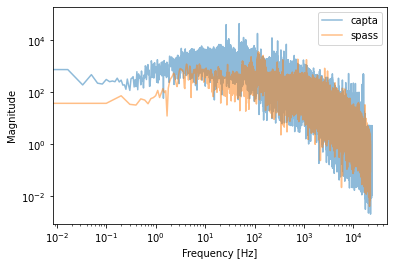

In [1]:
import numpy as np
import scipy.fft 
import matplotlib.pyplot as plt
import torchaudio
from IPython.display import Audio

def get_spectrum(path):
    waveform, sample_rate = torchaudio.load(path)
    waveform = waveform.numpy()[0]
    waveform = waveform/np.amax(np.abs(waveform))
    spectrum = scipy.fft.rfft(waveform)
    freqs = scipy.fft.rfftfreq(n=len(waveform), d=1/sample_rate)    
    return freqs, np.abs(spectrum), Audio(waveform, rate=sample_rate)


capta_freq, capta_mspec, audio1 = get_spectrum('example.wav')
spass_freq, spass_mspec, audio2 = get_spectrum('../../datasets/Poliphonic-street/audios/streetTEST00002.wav')

fig, ax = plt.subplots(figsize=(6, 4), facecolor='w')
ax.plot(capta_freq, np.abs(capta_mspec), label='capta', alpha=0.5)
ax.plot(spass_freq, np.abs(spass_mspec), label='spass', alpha=0.5)
ax.set_yscale('log')
ax.set_xscale('log')
ax.set_xlabel('Frequency [Hz]')
ax.set_ylabel('Magnitude')
ax.legend()

display(audio1, audio2)

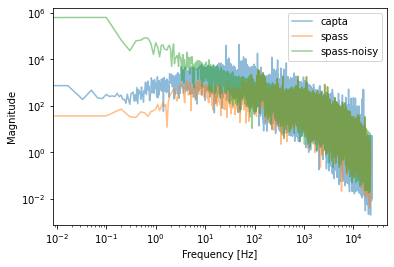

In [2]:
def noise_psd(N, beta=1.):
    X_white = scipy.fft.rfft(np.random.randn(N));
    S = np.fft.rfftfreq(N)
    S[S>0] = S[S>0]**beta
    # Normalize S
    #S = S / np.sqrt(np.mean(S**2))
    X_shaped = X_white * S;
    noise = np.real(scipy.fft.irfft(X_shaped))
    return noise/np.amax(np.abs(noise))

def get_spectrum_noisified(path, beta, SNR):
    waveform, sample_rate = torchaudio.load(path)
    waveform = waveform.numpy()[0]
    waveform = waveform/np.amax(np.abs(waveform))
    waveform += SNR*noise_psd(len(waveform), beta)
    #print(np.amin(waveform), np.amax(waveform))
    spectrum = scipy.fft.rfft(waveform)
    freqs = scipy.fft.rfftfreq(n=len(waveform), d=1/sample_rate)    
    return freqs, np.abs(spectrum), Audio(waveform/np.amax(np.abs(waveform)), rate=sample_rate)

spass_freqn, spass_mspecn, audio3 = get_spectrum_noisified('../../datasets/Poliphonic-street/audios/streetTEST00002.wav',
                                                         beta=-1., SNR=5.)

fig, ax = plt.subplots(figsize=(6, 4), facecolor='w')
ax.plot(capta_freq, np.abs(capta_mspec), label='capta', alpha=0.5)
ax.plot(spass_freq, np.abs(spass_mspec), label='spass', alpha=0.5)
ax.plot(spass_freqn, np.abs(spass_mspecn), label='spass-noisy', alpha=0.5)
ax.set_yscale('log')
ax.set_xscale('log')
ax.set_xlabel('Frequency [Hz]')
ax.set_ylabel('Magnitude')
ax.legend()

display(audio1, audio2, audio3)

In [5]:
from scipy.interpolate import interp1d
from scipy.optimize import minimize

interpolator = interp1d(capta_freq, np.log(np.abs(capta_mspec)))

def objective(params):
    SNR, beta = params
    spass_freqn, spass_mspecn, audio3 = get_spectrum_noisified('../../datasets/Poliphonic-street/audios/streetTEST00002.wav',
                                                         beta=beta, SNR=SNR)
    
    return np.sum((np.log(np.abs(spass_mspecn)) - interpolator(spass_freqn))**2)


res = minimize(objective, x0=[5.0, -1.0], options={'disp': True})
print(res.x)

         Current function value: 218487.826974
         Iterations: 1
         Function evaluations: 63
         Gradient evaluations: 17
[ 4.99999822 -1.00000738]


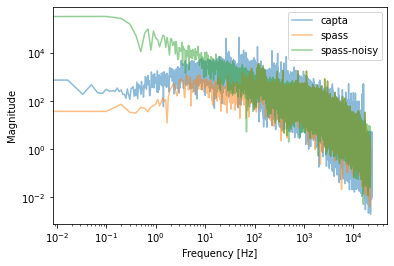

In [6]:
spass_freqn, spass_mspecn, audio3 = get_spectrum_noisified('../../datasets/Poliphonic-street/audios/streetTEST00002.wav',
                                                         beta=res.x[1], SNR=res.x[0])

fig, ax = plt.subplots(figsize=(6, 4), facecolor='w')
ax.plot(capta_freq, np.abs(capta_mspec), label='capta', alpha=0.5)
ax.plot(spass_freq, np.abs(spass_mspec), label='spass', alpha=0.5)
ax.plot(spass_freqn, np.abs(spass_mspecn), label='spass-noisy', alpha=0.5)
ax.set_yscale('log')
ax.set_xscale('log')
ax.set_xlabel('Frequency [Hz]')
ax.set_ylabel('Magnitude')
ax.legend()

display(audio1, audio2, audio3)